In [1]:
# Install the required libraries (from pip_requirements.txt)
%pip install -r pip_requirements.txt

!python -m spacy download en_core_web_sm


     ---------------------------------------- 0.0/981.5 kB ? eta -:--:--
     -------------------------------------- 981.5/981.5 kB 9.2 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for langdetect: filename=langdetect-1.0.9-py3-none-any.whl size=993251 sha256=3a9eed80e32d206edee9ee106610fc115f3773dfc7985f98f7924112abc819eb
  Stored in directory: c:\users\oscar\appdata\local\pip\cache\wheels\0a\f2\b2\e5ca405801e05eb7c8ed5b3b4bcf1fcabcd6272c167640072e
Successfully built langdetect
     ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
     ------- -------------------------------- 2.4/12.8 MB 14.9 MB/s eta 0:00:01
     ---------------- ----------------------- 5.2/12.8 MB 14.5 MB/s eta 0:00:01
     -------------------------- ------------- 8.4/12.8 MB 14.4 MB/s eta 0:00:01
     ---------------------------------- ---- 11.3/12.8 MB 14.1 MB/s eta 0:00:01
     -----------------------------

# Initial analysis

In [2]:
# Modules to import
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from importlib import reload
import json
import ast
from sklearn.metrics import silhouette_score, r2_score
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
import statsmodels.formula.api as smf
import geopandas as gpd
from itertools import combinations
from shapely.geometry import Point


In [5]:
paths = ['src/data','src/models','src/scripts','src/utils']
for path in paths:
    sys.path.append(path)

## I. Data preprocessing

### I.1 Original data

In [4]:
# Execute dataCleaning.py
# This script create dictionaries of freebase_id, convert date to datetime object, transform our columns

%run src/scripts/dataCleaning.py

Movies successfully loaded
Characters successfully loaded
Clusters successfully loaded
Summaries successfully loaded
Dates successfully converted
Build of countries dictionnary...
Build of languages dictionnary...
Build of genres dictionnary...
Build of actors dictionnary...
Build of character dictionnary...
Build of movies dictionnary...
Dictionnaries successfully saved
Saved movies_cleaned to data/cleanData/movies_cleaned.csv
Saved characters_cleaned to data/cleanData/characters_cleaned.csv
Saved character_clusters_cleaned to data/cleanData/character_clusters_cleaned.csv
Saved summaries_cleaned to data/cleanData/summaries_cleaned.csv
Datasets successfully saved
Data cleaning successfully done


Load the data

In [5]:
# Import dataloader function
from dataLoader import loadDataframe

In [6]:
# Load data
path_to_directory = 'data/cleanData/'
df_movies = loadDataframe('movies', path_to_directory)
df_characters = loadDataframe('characters', path_to_directory)
df_clusters = loadDataframe('clusters', path_to_directory)
df_summaries = loadDataframe('summaries', path_to_directory)

c:\Users\Oscar\Project ADA\ada-2024-project-teamcsx24\src/data\dataLoader.py:10: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df[columns_to_convert] = df[columns_to_convert].applymap(eval)


Data statistics overview

In [7]:
print(df_movies.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81741 entries, 0 to 81740
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   wiki_id                81741 non-null  int64         
 1   freebase_id            81741 non-null  object        
 2   original_title         81741 non-null  object        
 3   release_date           74839 non-null  datetime64[ns]
 4   revenue                8401 non-null   float64       
 5   runtime                61291 non-null  float64       
 6   languages              81741 non-null  object        
 7   countries              81741 non-null  object        
 8   genres                 81741 non-null  object        
 9   countries_freebase_id  81741 non-null  object        
 10  languages_freebase_id  81741 non-null  object        
 11  genres_freebase_id     81741 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(8)
memory

In [8]:
df_movies.describe()

,wiki_id,release_date,revenue,runtime
count,8.174100e+04,74839,8.401000e+03,6.129100e+04
mean,1.740784e+07,1977-10-12 15:39:00.849022592,4.799363e+07,1.118192e+02
min,3.300000e+02,1888-01-01 00:00:00,1.000000e+04,0.000000e+00
25%,7.323695e+06,1956-01-01 00:00:00,2.083193e+06,8.100000e+01
50%,1.777899e+07,1985-05-20 00:00:00,1.063969e+07,9.300000e+01
75%,2.715573e+07,2004-01-01 00:00:00,4.071696e+07,1.060000e+02
max,3.750192e+07,2016-06-08 00:00:00,2.782275e+09,1.079281e+06
std,1.098791e+07,NaN,1.121753e+08,4.360070e+03


In [9]:
# Non null values proportion
df_movies.isnull().mean()

wiki_id                  0.000000
freebase_id              0.000000
original_title           0.000000
release_date             0.084437
revenue                  0.897224
runtime                  0.250180
languages                0.000000
countries                0.000000
genres                   0.000000
countries_freebase_id    0.000000
languages_freebase_id    0.000000
genres_freebase_id       0.000000
dtype: float64

The features that we are interested in are the following:
- 'release_date' : more than 80% of the movies have a release date
- 'genre' : 100% of the movies have a genre
- 'countries' : 100% of the movies have a country
- 'languages' : 100% of the movies have a language

So we have a large amount of non null values that we can use to make our analysis. 

In [10]:
from generalUtils import intersectionId

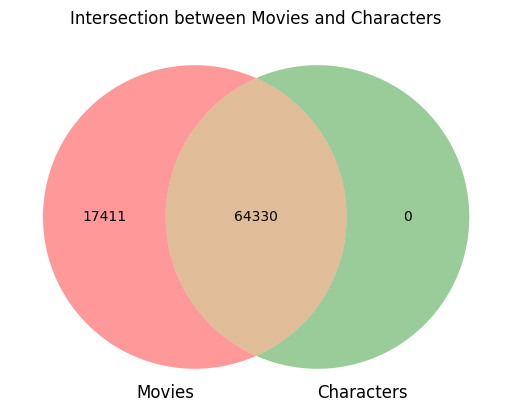

In [11]:
intersectionId(df_movies, df_characters, 'Movies', 'Characters', id_column='wiki_id')

### I.2 Additional data

#### I.2.1 Additional movie dataset from Kaggle

Because the revenue is important for the Economics part of our analysis we try to add a new dataset from Kaggle with movies to add more consistency to our results.

The new dataset has the revenue and the budget as interesting features for the Economics analysis.

In [12]:
#Execute additionaldataCleaning.py
#This script create dictionaries of freebase_id, convert date to datetime object, transform our columns TO CHANGE

%run src/scripts/additionaldataCleaning.py

Additional Movies successfully loaded
Monthly inflation data successfully loaded
Budget successfully converted
Filtered additional movie data successfully created
Inflation data successfully processed
Saved Kaggle_US_CPI_monthly_cleaned to data/cleanData/Kaggle_US_CPI_monthly_cleaned.csv
Saved monthly inflation data to Kaggle_US_CPI_monthly_cleaned.csv
Saved Kaggle_US_CPI_annual_cleaned to data/cleanData/Kaggle_US_CPI_annual_cleaned.csv
Saved annual inflation data to Kaggle_US_CPI_annual_cleaned.csv
Saved Kaggle_movie_data_tmdb_cleaned to data/cleanData/Kaggle_movie_data_tmdb_cleaned.csv
Saved additional movie data to Kaggle_movie_data_tmdb_cleaned.csv
Saved Kaggle_movie_data_tmdb_filtered_cleaned to data/cleanData/Kaggle_movie_data_tmdb_filtered_cleaned.csv
Saved filtered additional movie data to Kaggle_movie_data_tmdb_filtered_cleaned.csv


Data statistics overview

In [13]:
from dataLoader import loadAdditionalDataframe

In [14]:
df_inflation_additional_annual = loadAdditionalDataframe('inflation_annual', path_to_directory)
df_inflation_additional_monthly = loadAdditionalDataframe('inflation_monthly', path_to_directory)  
df_movies_additional = loadAdditionalDataframe('movies_additional', path_to_directory)
df_movies_additional_filtered = loadAdditionalDataframe('movies_additional_filtered', path_to_directory)

In [15]:
df_movies_additional.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119931 entries, 0 to 119930
Data columns (total 7 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   imdb_id            114475 non-null  object 
 1   original_title     119392 non-null  object 
 2   original_language  119392 non-null  object 
 3   budget             119074 non-null  float64
 4   revenue            119071 non-null  object 
 5   release_date       118642 non-null  object 
 6   title              118752 non-null  object 
dtypes: float64(1), object(6)
memory usage: 6.4+ MB


In [16]:
# Non null values proportion
df_movies_additional.isnull().mean()

imdb_id              0.045493
original_title       0.004494
original_language    0.004494
budget               0.007146
revenue              0.007171
release_date         0.010748
title                0.009831
dtype: float64

The features that we are interested in are the following:
- 'original_title' : more than 99% of the movies have a title
- 'revenue' : more than 99% of the movies have a revenue
- 'budget' : more than 99% of the movies have a budget

So we have a large amount of non null values that we can use to make our economics analysis.

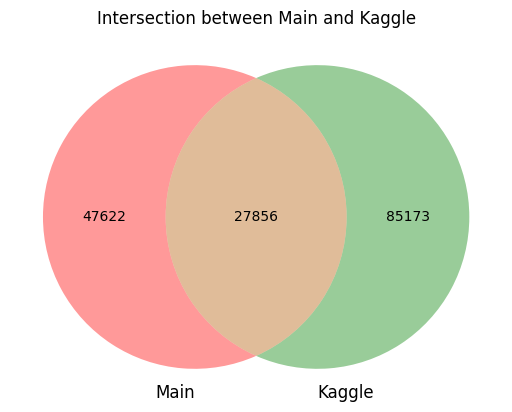

In [17]:
intersectionId(df_movies, df_movies_additional, 'Main', 'Kaggle', id_column='original_title')

More than 27,000 movies from the original database are intersected with the Kaggle dataset choosing the original_title as a common key.

In [18]:
df_movies_additional.loc[df_movies_additional['budget'] != 0].count()

imdb_id              14391
original_title       14504
original_language    14504
budget               14186
revenue              14496
release_date         14431
title                14178
dtype: int64

However, after a deeper analysis on the Kaggle dataset we realize that only ~14,000 values are not null for the budget and the revenue. So, a lot of implicit missing values were hidden in the Kaggle dataset.

Additional movie data from Kaggle where budget is not null

In [19]:
df_movies_additional_filtered.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15043 entries, 0 to 15042
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   imdb_id            14391 non-null  object 
 1   original_title     14504 non-null  object 
 2   original_language  14504 non-null  object 
 3   budget             14186 non-null  float64
 4   revenue            14496 non-null  object 
 5   release_date       14431 non-null  object 
 6   title              14178 non-null  object 
dtypes: float64(1), object(6)
memory usage: 822.8+ KB


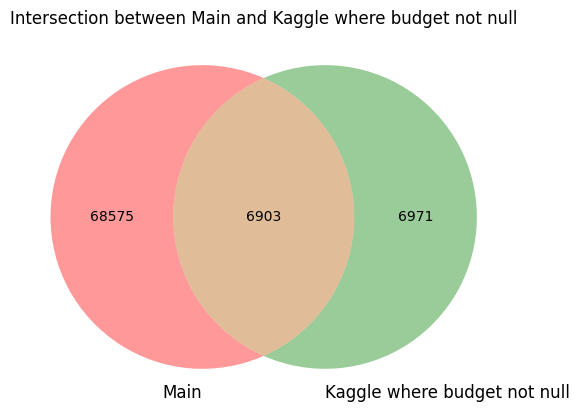

In [20]:
intersectionId(df_movies, df_movies_additional_filtered, 'Main', 'Kaggle where budget not null', id_column='original_title')

Finally, we realize that only 6,903 movies from the original database are intersected with the Kaggle dataset choosing the original_title as a common key.

This is much lower than we had hoped, which makes the dataset irrelevant in our case, as the feature revenue of the original dataset had 8401 non-zero values.

### I.2.2 Inflation dataset from Kaggle

Because we are going to study the revenue of movies it is also important to consider the Inflation by importing a dataset from Kaggle. Without adjusting for inflation, raw revenue data can be misleading, underestimating or overestimating the relative success of films from past eras. Adjusting for inflation makes analyses much more relevant and nuanced for understanding the evolution of the film industry. We make the assumption that the Consumer Price Index of the USA is representative of the rest of the world.

In [21]:
df_inflation_additional_monthly.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1296 entries, 0 to 1295
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Yearmon  1296 non-null   datetime64[ns]
 1   CPI      1296 non-null   float64       
 2   year     1296 non-null   int32         
dtypes: datetime64[ns](1), float64(1), int32(1)
memory usage: 25.4 KB


In [22]:
df_inflation_additional_annual.describe()

,year,CPI
count,108.00000,108.000000
mean,1966.50000,81.641431
std,31.32092,79.760606
min,1913.00000,9.883333
25%,1939.75000,17.495833
50%,1966.50000,32.908333
75%,1993.25000,145.400000
max,2020.00000,258.811167


The annual inflation dataset from 1913 to 2020 will be used to readjust the revenue of movies considering the year of release.

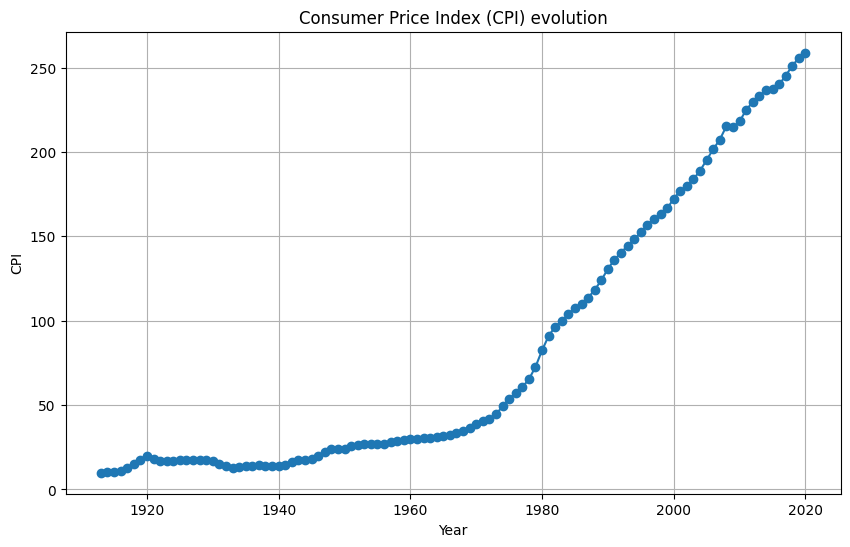

In [23]:
# plot the temporal evolution of the Consumer Price Index (CPI)
plt.figure(figsize=(10, 6))
plt.plot(df_inflation_additional_annual['year'], df_inflation_additional_annual['CPI'], marker='o')
plt.title('Consumer Price Index (CPI) evolution')
plt.xlabel('Year')
plt.ylabel('CPI')
plt.grid()
plt.show()


# III. Culture

For both **Genre Analysis (III.1)** and **Topic Modeling (III.2)**, we utilize a single script to process the input data and generate the necessary datasets for analysis. The script is untitled `prepareDataCulture.py` and is located in the `scripts` directory.

### Overview of the Script  
The script performs the following tasks:  
1. **Genre Analysis**:  
   - Transforms movie cleaned data (genres, countries, and release dates) into a structured format.  
   - Maps countries to their corresponding world regions.  
   - Generates aggregated datasets for genres by region and by country.  

2. **Topic Modeling**:  
   - Merges the topic modeling results with the movie metadata.  
   - Creates a unified dataset containing topics, genres, and associated metadata.  

### Output Datasets  
1. **Genre Analysis Outputs**:  
   - `df_genres_countries_exploded.csv`: Exploded data with combinations of genres, countries, and years.  
   - `df1.csv`: Aggregated genre counts by region and year.  
   - `df2.csv`: Aggregated genre counts by country and year.  

2. **Topic Modeling Outputs**:  
   - `df_movies_with_topics.csv`: Dataset containing movies with their associated topics and genres.  

We will now run the script to prepare these datasets.

In [24]:
# Run the data preparation script
%run src/scripts/prepareDataCulture.py

C:\Users\Oscar\Project ADA\ada-2024-project-teamcsx24\src\scripts\prepareDataCulture.py:22: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_movies[columns_to_convert] = df_movies[columns_to_convert].applymap(eval)


Preparing the data for the genre analysis...
Transforming the country names...
Exploding the genres and countries...
Number of movies before and after dropping movies without countries, release date and genres:
Total number of movies: 81741
Total number of movies with countries, release date and genres: 68144
Pourcentage of dropped movies: 16.63%
Attaching the world region to the countries...
Saving the data...
Genre analysis data ready!
Preparing the data for the topic analysis...
Saving the data...
Topic analysis data ready!


## III.1) Genre analysis

This section focuses on the evolution of movie genres across years and regions. The analysis begins by identifying the most common genres, their distribution across countries, and their progression over time. We'll also explore regional trends and calculate diversity scores to measure the evenness and richness of genres.

In [25]:
df_genres_countries_exploded = pd.read_csv('data/cultureData/df_genres_countries_exploded.csv')
df_genres_countries_exploded.head()

,wiki_id,freebase_id,original_title,release_date,countries,genres,region,year
0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,United States of America,Thriller,North America,2001
1,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,United States of America,Science Fiction,North America,2001
2,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,United States of America,Horror,North America,2001
3,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,United States of America,Adventure,North America,2001
4,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,United States of America,Supernatural,North America,2001


The dataset we are working with provides detailed information about movies, including their titles, release dates, genres, countries, and regions. The data is structured as follows:

- **wiki_id**: Unique identifier for the movie in the Wikipedia database.
- **freebase_id**: Unique identifier for the movie in the Freebase database.
- **original_title**: The title of the movie.
- **release_date**: The date when the movie was released.
- **countries**: The country or countries where the movie was produced or released.
- **genres**: The genre or genres associated with the movie.
- **region**: The region (such as North America, Europe, etc.) where the movie was produced or became popular.
- **year**: The year when the movie was released.

In [26]:
print("Number of unique genres: ", df_genres_countries_exploded['genres'].nunique())
print(df_genres_countries_exploded['genres'].unique())

Number of unique genres:  362
['Thriller' 'Science Fiction' 'Horror' 'Adventure' 'Supernatural' 'Action'
 'Space western' 'Mystery' 'Biographical film' 'Drama' 'Crime Drama'
 'Crime Fiction' 'Erotic thriller' 'Psychological thriller' 'Short Film'
 'Silent film' 'Indie' 'Black-and-white' 'Comedy' 'Family Film' 'Fantasy'
 'World cinema' 'Musical' 'Japanese Movies' 'Action/Adventure'
 'Romantic comedy' 'Ensemble Film' 'Comedy-drama' 'Romantic drama'
 'Romance Film' 'Costume drama' 'War film' 'Epic' 'Period piece'
 'Film adaptation' "Children's/Family" "Children's Fantasy" 'Future noir'
 'Comedy film' 'Coming of age' 'Suspense' 'Crime Thriller' 'Black comedy'
 'Bollywood' 'Marriage Drama' 'Wuxia' 'Martial Arts Film' 'Chinese Movies'
 'Western' 'Parody' 'Mockumentary' 'Fan film' 'Cult' 'Adventure Comedy'
 'Slapstick' 'Biopic [feature]' 'Historical Epic' 'Sports' 'Family Drama'
 'Political drama' 'Historical fiction' 'Courtroom Drama'
 'Culture & Society' 'Biography' 'Documentary' 'Christmas

There are 362 different genres in the dataset. The most common genres are Drama, Comedy and Romance. To begin with, we will analyze the evolution of the most common genres over years and countries.

### III.1.1) Most common genres

We begin by identifying the **most common genres** across all the countries in the dataset. This is achieved by counting the occurrences of each genre using `value_counts()` and selecting the top 10 genres.

- **Plot**: A **bar chart** is then created using Plotly's `go.Bar` where the x-axis represents the genres, and the y-axis represents the number of movies for each genre.

The bar chart is configured with a title and axis labels for clarity.

In [27]:
most_common_genres = df_genres_countries_exploded['genres'].value_counts().head(10)

#Plotly bar chart
fig = go.Figure(data=[go.Bar(x=most_common_genres.index, y=most_common_genres.values)])
fig.update_layout(title='Most common genres', xaxis_title='Genres', yaxis_title='Number of movies')
fig.show()
fig.write_html("htmlSavedGraph/most_common_genres.html")

To study the **growth of genres** over time, we calculate the number of movies released each year for the top 10 genres. This is done by grouping the data by `year` and `genre` and counting the number of movies for each genre in each year.

As each genre doesn't exist since the beginning of the dataset, we should add a value of 0 for each pair (year, genre) that doesn't exist in the dataset. We do so to prevent problems in the visualization of the race plot coming next.

- **Plot**: An animated **bar race plot** is created to visualize the top 10 genres by year. The bars represent the cumulative number of movies for each genre, with the animation showing the evolution of these counts over time. This allows us to track the growth of each genre and observe how their popularity changes across the years.


In [28]:
# Number of movies per genre per year
df_nb_movies_genre_year = df_genres_countries_exploded.groupby(['year', 'genres']).size().reset_index(name='count')

# Complete the dataframe with missing genres for each year (filling with 0)
all_genres = df_genres_countries_exploded['genres'].unique()
all_years = df_genres_countries_exploded['year'].unique()
all_combinations = [(year, genre) for year in all_years for genre in all_genres]
df_nb_movies_genre_year = df_nb_movies_genre_year.merge(pd.DataFrame(all_combinations, columns=['year', 'genres']), on=['year', 'genres'], how='right')
df_nb_movies_genre_year['count'] = df_nb_movies_genre_year['count'].fillna(0)

# Cumulative number of movies per genre
df_cumulative_nb_movies_genre_year = df_nb_movies_genre_year.groupby(['year', 'genres'])['count'].sum().groupby('genres').cumsum().reset_index(name='cumulative_count')

# Get the top 10 genres by year
top_genres_df = df_cumulative_nb_movies_genre_year.groupby(['year', 'genres']).sum().reset_index()
top_genres_df = top_genres_df.sort_values(by=['year', 'cumulative_count'], ascending=[True, False])
top_genres_df = top_genres_df.groupby('year').head(10)

# Create the animated bar race plot
fig = px.bar(top_genres_df,
             x='cumulative_count',
             y='genres',
             animation_frame='year',
             orientation='h',
             title='Top 10 Genres by Year',
             labels={'cumulative_count': 'Cumulative Count', 'genres': 'Genres'},
             color='genres',
             color_discrete_sequence=px.colors.qualitative.Plotly)  # Use a qualitative color palette

# Update layout for better visualization and set the time interval between frames
fig.update_layout(height=600, width=800, yaxis=dict(categoryorder='total ascending'), showlegend=False)

# Reduce the thickness of the bars
fig.update_traces(marker=dict(line=dict(width=0.5, color='DarkSlateGrey')), selector=dict(type='bar'))

# Show the plot
fig.show()
fig.write_html("htmlSavedGraph/top_10_genres_by_year.html")

Then, we explore when different genres appeared in different countries. To do this, we first find the **earliest year** each genre was introduced using `groupby('genre')` and `min('release_date')` functions. We then merge this data with the original dataset to obtain information about the corresponding countries for each genre in its first appearance year.

- **Plot**: A **scatter plot** is created with `release_date` on the x-axis and `countries` on the y-axis. The colors represent different genres, providing a visual timeline of when each genre first appeared in each country.

In [29]:
# Timeline of apparition of genres
first_year_genre = df_genres_countries_exploded.groupby('genres')['release_date'].min().reset_index()
first_year_genre = first_year_genre.merge(df_genres_countries_exploded[['genres','countries','release_date']], on=['genres','release_date'], how='left')

# Plot a 2D graph with x=year, y=country, color=genre
fig = px.scatter(first_year_genre, x='release_date', y='countries', color='genres')
fig.update_layout(
    title='Timeline of apparition of genres',
    yaxis=dict(
        title='Countries',
        categoryorder='total ascending',  
        tickmode='array',
        tickvals=first_year_genre['countries'].unique(),
        automargin=True
    )
)
fig.show()
fig.write_html("htmlSavedGraph/timeline_genres.html")

Next, we calculate how many **unique genres** have first appeared in each country. This is done by grouping the data by `countries` and counting the number of distinct genres using `nunique()`.

- **Plot**: A **histogram** is created where the x-axis represents countries, and the y-axis represents the number of genres that first appeared in each country.


In [30]:
# Count the number of unique genres per country
genre_count_by_country = (
    first_year_genre.groupby('countries')['genres']
    .nunique()
    .reset_index()
    .rename(columns={'genres': 'genre_count'})
)

# Histogram of number of genres (y axis) per country (x axis)
fig = px.histogram(genre_count_by_country, x='countries', y='genre_count')
fig.update_layout(
    title='Number of genres first apparition per country',
    xaxis=dict(
        title='Countries',
        categoryorder='total descending',  
        tickmode='array',
        tickvals=genre_count_by_country['countries'].unique(),
        automargin=True
    ),
    yaxis=dict(
        title='Number of genres'
    )
)
fig.show()
fig.write_html("htmlSavedGraph/genre_apparition_count_by_country.html")

## III.1.2 Analysis per World Region

In [31]:
df = pd.read_csv('data/cultureData/df1.csv')
# Drop movies whose year is after 2008 (much less data which is not representative)
df = df[df['year'] <= 2008]
df.head()

,region,year,genres,count
0,Africa,1916,Drama,1
1,Africa,1916,Historical fiction,1
2,Africa,1916,Silent film,1
3,Africa,1932,Black-and-white,1
4,Africa,1932,Drama,1


Here we use a dataset that contains the number of movies of each genre for each year and region. The dataset is structured as follows:
- **region**: The broad geographical region (such as North America, Africa, etc.) where the movie genre became popular or emerged.
- **year**: The year in which the movie genre was first recorded in the dataset.
- **genres**: The genre associated with the movie.
- **count**: The number of movies of that genre recorded for the given year and region.

We first create an **interactive line plot** that shows the number of movies for each genre by region over time. We can select different genres through a dropdown menu, which will update the plot to display the data for the selected genre and its evolution over the years.

- **Plot**: The plot consists of multiple lines, each representing a genre in a specific region, with color-coded lines for different regions. The dropdown menu allows the user to toggle between genres.

In [32]:
def interactive_genre_region_plot(data):
    # Initialize figure
    fig = go.Figure()
    data['region'] = data['region'].astype(str)
    
    # Define colors for each region
    region_color_mapping = {
    "Oceania": "#1f77b4",  # Blue
    "Africa": "#ff7f0e",  # Orange
    "Middle East": "#2ca02c",  # Green
    "South Asia": "#d62728",  # Red
    "East and Southeast Asia": "#9467bd",  # Violet
    "South America": "#8c564b",  # Brown
    "Europe": "#e377c2",  # Rose
    "North America": "#7f7f7f",  # Grey
    "Eastern Europe and Central Asia": "#bcbd22",  # Olive Green
    }
    
    # Initial genre
    genre_init = data['genres'].unique()[0]
    
    # Add traces for each genre
    for genre in data['genres'].unique():
        for i, region in enumerate(data['region'].unique()):
            data_region_genre = data[(data['genres'] == genre) & (data['region'] == region)].groupby('year', as_index=False).sum()
            
            # Assign a color to each region
            color = region_color_mapping[region]
            
            # Add trace
            fig.add_trace(go.Scatter(
                x=data_region_genre['year'],
                y=data_region_genre['count'],
                mode='lines+markers',
                name=f'{genre} - {region}',
                line=dict(color=color),
                visible= True if genre == genre_init else False
            ))
            
    # Create a dropdown menu to select the genre
    buttons = []
    for genre in data['genres'].unique():
        visibility = [trace.name.startswith(f'{genre} -') for trace in fig.data]

        button = {
            'label': genre,
            'method': 'update',
            'args': [
                {'visible': visibility},  # Update visibility of traces
                {'title': f"Number of movies for {genre} genre by region over the years"}  # Update title
            ]
        }
        buttons.append(button)
    
    # Update layout with dropdown menu and styling
    fig.update_layout(
        updatemenus=[{
            'buttons': buttons,
            'direction': 'down',
            'showactive': True,
            'x': 0.5,
            'y': 1.15,
            'xanchor': 'center',
            'yanchor': 'top'
        }],
        title={
            'text': f"Number of movies for {data['genres'].unique()[0]} genre by region over the years",
            'y': 0.95,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top',
            'font': dict(size=20, family='Arial, sans-serif')
        },
        xaxis=dict(
            title='Year',
            titlefont=dict(size=16),
            tickfont=dict(size=12),
            showgrid=True,
            gridcolor='lightgrey',
            zeroline=False
        ),
        yaxis=dict(
            title='Number of movies',
            titlefont=dict(size=16),
            tickfont=dict(size=12),
            showgrid=True,
            gridcolor='lightgrey',
            zeroline=False
        ),
        legend=dict(
        title='Legend',
        x=1.05,
        y=0.5,
        xanchor="left",
        yanchor="middle",
        bordercolor="Black",
        borderwidth=1,
        font=dict(size=12)
        ),
    plot_bgcolor='white'
    )

    # Add grid lines and background
    fig.update_xaxes(showline=True, linewidth=1, linecolor='black', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='black', mirror=True)

    # Show the figure
    fig.show()
    fig.write_html("htmlSavedGraph/interactive_genre_region_plot.html")
    
interactive_genre_region_plot(df)
    

Additionally, we generate **pie charts** to show the top 5 genres for each region. These pie charts are displayed in a 3x3 grid layout, providing a visual comparison of genre distributions across regions.

- **Plot**: Pie charts representing the distribution of the top 5 movie genres per region, shown in a grid layout.

In [33]:
def interactive_genre_region_pie(data):
    # Define regions
    regions = data['region'].unique()

    # Create a subplot layout for multiple pie charts (3x3 grid)
    rows = (len(regions) // 3) + (1 if len(regions) % 3 > 0 else 0)  # Calculate number of rows
    cols = min(3, len(regions))  # Limit to 3 columns

    # Create a subplot figure
    fig = make_subplots(
        rows=rows, cols=cols,
        subplot_titles=regions,
        specs=[[{"type": "domain"}]*cols] * rows
    )

    # Add a pie chart for each region
    for idx, region in enumerate(regions):
        row = idx // 3 + 1  # Determine the row index
        col = idx % 3 + 1  # Determine the column index

        region_data = data[data["region"] == region]
        top_genres = (
            region_data.groupby("genres")["count"]
            .sum()
            .nlargest(5)
            .reset_index()
        )
        
        # Add the pie chart for this region
        fig.add_trace(
            go.Pie(
                labels=top_genres["genres"],
                values=top_genres["count"],
                name=region,
                legendgroup="genres",  # Group legends across all pie charts
                # Adding custom colors for the genres (optional)
            ),
            row=row, col=col
        )

    # Update layout for shared legend and common title
    fig.update_layout(
        title_text="Top 5 Genres for All Regions",
        title_x=0.5,  # Center the title
        height=350 * rows,  # Adjust height based on number of rows
        showlegend=True,  # Show the legend
        legend=dict(
            orientation="v",  # Vertical legend
            x=1.05,  # Move legend to the right
            y=0.5,
            yanchor="middle",
            title="Genres"  # Title for the legend
        )
    )

    # Show the figure
    fig.show()
    fig.write_html("htmlSavedGraph/interactive_genre_region_pie.html")

# Example call
interactive_genre_region_pie(df)

Then, we interest ourselves in the **diversity of genres** in different regions and time periods, we calculate a **personalized diversity score**. This score combines two factors:

1. **Number of genres (Richness of genres)**: This reflects the total variety of genres present in the films produced during the given period.
2. **Relative distribution of genres (Evenness of distribution)**: This assesses how evenly films are distributed across genres, with a focus on avoiding dominance by a single genre.

The formula for the personalized diversity score is:

$$
\text{final\_score} = \text{genre\_score} + \text{distribution\_score}
$$

Where:
- **Genre Score** reflects the richness of the genres in the region. It is calculated based on the number of unique genres present in a period, with the following formula:
  
  $$
  \text{genre\_score} = \min \left( 0.5, \frac{\text{num\_genres}}{5} \times 0.05 \right)
  $$
  - $ \text{num\_genres} $ is the number of unique genres in a given period.
  - For every 5 genres, we assign 0.05 points, and the score is capped at 0.5 points for 50 or more genres.
  
- **Distribution Score** reflects how evenly films are distributed across genres. It is based on the **Gini index**, a commonly used measure of inequality in distributions. The formula for the distribution score is:

  $$
  \text{distribution\_score} = 0.5 \times (1 - \text{Gini\_Index})
  $$

  - The Gini index $ G $ is calculated using the proportions of films in each genre:
  
    $$
    G = 1 - \sum_{i=1}^{n} p_i^2
    $$

    where $ p_i $ is the proportion of films in the $ i $-th genre, and $ n $ is the total number of genres in the period.
  
  - A **Gini index close to 0** (meaning equal distribution across genres) results in a **high distribution score** (close to 0.5).
  - A **Gini index close to 1** (meaning highly uneven distribution) results in a **low distribution score** (close to 0).

Thus, the final score is a combination of both richness and evenness, with both factors contributing **50%** to the overall score.

- **Plot**: A line plot showing the evolution of the diversity score for each region over time, broken into 5-year periods. The user can toggle between regions using a dropdown menu.

In [34]:
# Function to calculate the Gini index
def calculate_gini(group):
    total_count = group['count'].sum()
    proportions = group['count'] / total_count
    sorted_proportions = np.sort(proportions)
    n = len(sorted_proportions)
    cumulative_proportions = np.cumsum(sorted_proportions)
    gini_index = (n + 1 - 2 * np.sum(cumulative_proportions)) / n
    return gini_index  # Lower values mean higher evenness

# Function to calculate the genre score (based on number of genres)
def calculate_genre_score(group):
    num_genres = len(group['genres'].unique())  # Number of unique genres
    genre_score = min(0.5, (num_genres / 5) * 0.05)
    return genre_score

# Function to calculate the distribution score (based on Gini index or Shannon entropy)
def calculate_distribution_score(group):
    # Calculate the Gini index
    gini_index = calculate_gini(group)
    distribution_score = 1 - gini_index  # Inverted Gini index
    return 0.5*distribution_score

# Function to calculate the final personalized score
def calculate_personalized_score(group):
    genre_score = calculate_genre_score(group)
    distribution_score = calculate_distribution_score(group)
    final_score = genre_score + distribution_score  # Sum of the two scores
    return final_score

In [35]:
# Group years into 5-year periods
df['period'] = (df['year'] // 5) * 5  # Create a period column for 5-year intervals

# Group by region and period, and calculate the normalized diversity score
diversity_scores = (
    df.groupby(['region', 'period'])
    .apply(calculate_personalized_score)
    .reset_index(name='diversity_score')
)

# Plot the diversity scores for each region
regions = diversity_scores['region'].unique()

# Initialize the figure
fig = go.Figure()

# Add a line plot for each region
for region in regions:
    filtered_data = diversity_scores[diversity_scores['region'] == region]
    fig.add_trace(go.Scatter(
        x=filtered_data['period'],
        y=filtered_data['diversity_score'],
        mode='lines+markers',
        name=region,
        text=filtered_data['region'],
        hoverinfo='text+y',
        line=dict(color='blue'),
        visible=(region == regions[0])  # Show the first region by default
    ))

# Create region selector dropdown
buttons = []
for region in regions:
    visibility = [region == r for r in diversity_scores['region'].unique()]
    buttons.append(
        {
            'label': region,
            'method': 'update',
            'args': [
                {'visible': visibility},
                {'title': f"Diversity Score for {region} (5-year periods)"}
            ]
        }
    )

# Update layout with the dropdown and other settings
fig.update_layout(
    height=400,
    width=700,
    title="Diversity Score Evolution by Region (5-year periods)",
    xaxis_title="Year",
    yaxis_title="Diversity Score",
    template='plotly',
    updatemenus=[{
        'buttons': buttons,
        'direction': 'down',
        'showactive': True,
        'x': 0.5,
        'xanchor': 'center',
        'y': 1.15,
        'yanchor': 'top'
    }],
    showlegend=True
)

# Show the figure
fig.show()
fig.write_html("htmlSavedGraph/diversity_score_evolution_by_region.html")

C:\Users\Oscar\AppData\Local\Temp\ipykernel_23892\1079336531.py:7: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



## III.1.3 Analysis per country

In [36]:
df2 = pd.read_csv('data/cultureData/df2.csv')
df2.head()

,countries,year,genres,count
0,Afghanistan,1975,Action/Adventure,1
1,Afghanistan,1975,Bollywood,1
2,Afghanistan,1975,Thriller,1
3,Afghanistan,1975,World cinema,1
4,Afghanistan,1992,Action/Adventure,1


Here we use a dataset that contains the number of movies of each genre for each year and country. The dataset is structured as the previous one but with the country instead of the region.

In [37]:
df_tot_nb_movies_per_genre_per_country = df2.groupby(['countries','genres']).size().reset_index(name='count')
df_most_genre_per_country = df_tot_nb_movies_per_genre_per_country.groupby('countries').apply(lambda x: x.nlargest(1, 'count')).reset_index(drop=True)

C:\Users\Oscar\AppData\Local\Temp\ipykernel_23892\3444441075.py:2: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [38]:
# Plot a world map with the most common genre per country
fig = px.choropleth(df_most_genre_per_country, 
                    locations='countries',
                    locationmode='country names',
                    color='genres',
                    title='Most common genre per country',
                    hover_name='genres',
                    projection='natural earth',
                    color_discrete_sequence=px.colors.qualitative.Light24_r)
fig.show()
fig.write_html("htmlSavedGraph/most_common_genre_per_country.html")

## III.2) Topic Modeling

In this section, we focus on exploring and visualizing topics identified from movie data. The goal is to observe how these topics evolve over time and across regions. The topic modeling has been performed using **BERTopic** library. All the processing steps are explained in the notebook `topicModeling.ipynb` in the folder `src/models`. To recap it briefly, the following steps were performed:
- Data Preprocessing: The movie data was preprocessed by removing stopwords, lemmatizing, and tokenizing the text.
- Topic Modeling: The BERTopic model was trained on the preprocessed text data to identify topics.
- Topic Data Prepartion: The topic data was prepared by assigning topics to each movie and extracting the most representative words for each topic.


In [39]:
df = pd.read_csv('data/cultureData/df_movies_with_topics.csv')
df['release_date'] = pd.to_datetime(df['release_date'])
df['year'] = df['release_date'].dt.year
df.head()

,wiki_id,topic_name,release_date,countries,region,year
0,20663735,Love & Family,2000-01-01,India,South Asia,2000
1,20663735,Love & Family,2000-01-01,India,South Asia,2000
2,20663735,Love & Family,2000-01-01,India,South Asia,2000
3,20663735,Love & Family,2000-01-01,India,South Asia,2000
4,1952976,Crime,2005-06-27,United States of America,North America,2005


The dataset has been created using the script (`prepareCultureData.py`), which is explain at the beginning of section IV. The dataset contains the following columns:

- **wiki_id**: Unique identifier for each movie.
- **topic_name**: The topic associated with the movie (e.g., "Martial Arts", "Middle East").
- **countries**: The countries where the movie was released.
- **region**: The region where the movie was primarily released.
- **release_date**: The release date of the movie.

The objective is to analyze the distribution and propagation of various topics across countries and regions.

In [40]:
# List of topics
df['topic_name'].unique()

array(['Love & Family', 'Crime', 'Investigation', 'Pirates',
       'Middle East', 'Civil War', 'Africa', 'Cartoons', 'Martial Arts',
       'USSR', 'Betty Boop', 'French Life', 'WWII', 'Samurai',
       'Sci-Fi Earth', 'Politics', 'Family Drama', 'Stooges',
       'Musketeers', 'Charlie Brown', 'Christmas', 'Space', 'Soldiers',
       'Laurel & Hardy', 'Boxing', 'Sports', 'Tom & Jerry', 'College',
       'Roman Empire', 'Royalty', 'Jungle', 'Tokyo Life', 'Racing',
       'Yakuza', 'Monsters', 'Fantasy', 'Disney', 'Godzilla',
       'Pink Panther', 'School Life'], dtype=object)

In [41]:
# Count number of unique wiki_id per topic
df.groupby('topic_name')['wiki_id'].nunique().sort_values(ascending=False)

topic_name
Love & Family     6137
Crime             4408
Investigation     1254
Martial Arts      1036
Family Drama       598
Sci-Fi Earth       558
Civil War          439
French Life        354
Space              324
WWII               322
Pirates            256
Soldiers           216
USSR               201
Sports             199
Monsters           185
Samurai            153
Cartoons           149
Royalty            143
Stooges            124
Christmas          123
Africa             118
Charlie Brown       98
College             88
Middle East         86
Tokyo Life          84
Tom & Jerry         83
Fantasy             81
Yakuza              76
Jungle              73
Musketeers          69
Racing              69
Laurel & Hardy      68
Godzilla            53
Betty Boop          53
Disney              51
Roman Empire        50
Politics            49
Boxing              48
School Life         40
Pink Panther        20
Name: wiki_id, dtype: int64

### III.2.1) Topic's mean propagation

We now focus on analyzing how each topic is propagated across regions and countries. We select a specific topic, for instance, 'Martial Arts', and calculate the number of countries, regions, and movies where this topic is present.

In [42]:
# Select a topic
topic = 'Martial Arts'

df_topic = df[df['topic_name'] == topic]

# Number of countries where the topic is present
print(f'Number of countries where the topic {topic} is present: {df_topic["countries"].nunique()}')

# Number of regions where the topic is present
print(f'Number of regions where the topic {topic} is present: {df_topic["region"].nunique()}')

# Number of movies where the topic is present
print(f'Number of movies where the topic {topic} is present: {df_topic["wiki_id"].nunique()}')


Number of countries where the topic Martial Arts is present: 33
Number of regions where the topic Martial Arts is present: 7
Number of movies where the topic Martial Arts is present: 1036


We compute the statistics for all topics, such as the number of countries, regions, and movies associated with each topic.

In [43]:
topic_stats = df.groupby('topic_name').agg(
    num_countries=('countries', 'nunique'),
    num_regions=('region', 'nunique'),
    num_movies=('wiki_id', 'nunique')
).reset_index()

# Compute average statistics
avg_countries = topic_stats['num_countries'].mean()
avg_regions = topic_stats['num_regions'].mean()
avg_movies = topic_stats['num_movies'].mean()

# Statistics per topic
print("Statistics per topic:")
topic_stats

Statistics per topic:


,topic_name,num_countries,num_regions,num_movies
0,Africa,30,7,118
1,Betty Boop,2,2,53
2,Boxing,9,6,48
3,Cartoons,10,4,149
4,Charlie Brown,10,5,98
5,Christmas,20,6,123
6,Civil War,20,8,439
7,College,13,6,88
8,Crime,53,9,4408
9,Disney,2,1,51


In [44]:
# Average statistics across all topics
print("Average statistics across all topics:")
print(f"Average number of countries per topic: {avg_countries:.2f}")
print(f"Average number of regions per topic: {avg_regions:.2f}")
print(f"Average number of movies per topic: {avg_movies:.2f}")

Average statistics across all topics:
Average number of countries per topic: 20.75
Average number of regions per topic: 5.85
Average number of movies per topic: 463.40


### III.2.2) World map visualization

We analyze a selection of topics and map their presence across countries. This analysis will allow us to visualize how the presence of these topics varies geographically.

- **Plot**: A world map showing the presence of a specific topic across countries.

In [45]:
# Selected topic for analysis
topics_list = ['Middle East','Africa','Martial Arts','USSR','French Life', 'Samurai', 'Tokyo Life','Roman Empire']

In [46]:
# Remove duplicates for each movie by country and topic
df_unique = df.drop_duplicates(subset=['wiki_id', 'countries', 'topic_name'])

# Add a column indicating presence (1)
df_unique['presence'] = 1

# Unique list of available topics
topics = topics_list

# Create a figure
fig = go.Figure()

# Add traces for each topic
for topic in topics:
    df_topic = df_unique[df_unique['topic_name'] == topic]
    fig.add_trace(
        go.Choropleth(
            locations=df_topic['countries'],
            locationmode='country names',
            z=df_topic['presence'],
            colorbar=dict(title='Presence'),
            colorscale='Blues',
            showscale=False,
            visible=(topic == topics[0])  # Show only the first topic initially
        )
    )

# Create buttons for topic selection
buttons = []
for i, topic in enumerate(topics):
    buttons.append(
        dict(
            label=topic,
            method='update',
            args=[{'visible': [t == topic for t in topics]},
                  {'title': f'Presence of the topic: {topic}'}]
        )
    )

# Add dropdown menu
fig.update_layout(
    updatemenus=[
        dict(
            buttons=buttons,
            direction='down',
            showactive=True,
            x=0.1,
            xanchor='center',
            y=1.15,
            yanchor='top'
        )
    ],
    title=f'Presence of the topic: {topics[0]}',
    geo=dict(
        showframe=False,
        showcoastlines=True,
        projection_type='equirectangular'
    )
)

# Show the figure
fig.show()
fig.write_html('htmlSavedGraph/topic_world_map.html')

C:\Users\Oscar\AppData\Local\Temp\ipykernel_23892\52973947.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## III.3) US Cultural Influence on foreign countries

In this section, our goal is to analyze the cultural influence of the United States in the film productions of other countries. To do this, we begin by defining a cultural influence score of the U.S. on films. We will then analyze this influence from a geographical perspective and attempt to cluster the countries of the world using this influence score.

In [6]:
import scriptculture
import generalUtils
reload(scriptculture)

<module 'scriptculture' from 'c:\\Users\\Oscar\\Project ADA\\ada-2024-project-teamcsx24\\src/scripts\\scriptculture.py'>

In [7]:
from scriptculture import process_data_us_influence          # Import the function that processes the data for this study

df_us_influence_final = process_data_us_influence()
df_us_influence_final.head()

,Country,US_Term_Count,Number of movies,Naïve_Influence_score,log Number of movies,World_region,NLP US Influence Score
0,France,531,2302,0.230669,7.741534,Europe,0.131262
1,Russia,49,484,0.101240,6.182085,Eastern Europe and Central Asia,0.099043
2,India,262,4754,0.055111,8.466742,South Asia,0.079816
3,Australia,160,748,0.213904,6.617403,Oceania,0.157515
4,New Zealand,34,256,0.132812,5.545177,Oceania,0.195417


For this analysis, we identified a list of typically american words. We then search for this words occurences in the different summaries. We then grouped the results by countries. This is the first method that we use for this analysis but it was not relevant.

We have implemented a U.S. influence score using Transformers (NLP model). The code and explanations for this model are detailed in the "nlp_code" notebook within the "models" directory.

The processed dataset that we'll use for this analysis is completed with the following features:

- US_Term_Count: Number of U.S. terms found in the movies from each country
- Number of movies: Number of movies produced in each country
- Naïve_Influence_score: Ratio of US_Term_Count to the Number of movies
- World_region: Geographical cluster that we identified
- NLP US Influence Score: The U.S. influence score on the country, calculated using the NLP model, is more precise than the Influence score and will be the focus of this analysis.


### III.3.1) Primary Analysis

From now on, the only influence score we will consider is the U.S. cultural influence score obtained through the NLP method.

Let’s start by observing the regression of this influence score with the log of the number of movies per country:

In [49]:

# Calculate the R^2 of the linear regression between the number of movies and the influence score of the USA
x = df_us_influence_final['log Number of movies']
y = df_us_influence_final['NLP US Influence Score']

# Perform the linear regression prediction 
z = np.polyfit(x, y, 1)
p = np.poly1d(z)
y_pred = p(x)

# Calculate R^2
r_squared = r2_score(y, y_pred)

print(f"R^2 : {r_squared:.4f}")

R^2 : 0.2279


In [50]:
z = np.polyfit(df_us_influence_final['log Number of movies'], df_us_influence_final['NLP US Influence Score'], 1) # Fit the linear regression model
p = np.poly1d(z)

# Interactive figure using Plotly
fig = go.Figure()

# Add points representing each country
fig.add_trace(go.Scatter(
    x=df_us_influence_final['log Number of movies'],
    y=df_us_influence_final['NLP US Influence Score'],
    mode='markers',
    marker=dict(color='blue', size=6, opacity=0.6),
    text=df_us_influence_final['Country'],  
    hovertemplate="<b>Country:</b> %{text}<br>" +
                  "<b>log(Number of Movies):</b> %{x}<br>" +
                  "<b>Influence Score:</b> %{y}<extra></extra>",
    name='Countries'
))

# Add the regression line
x_vals = np.linspace(df_us_influence_final['log Number of movies'].min(), 
                     df_us_influence_final['log Number of movies'].max(), 100)
y_vals = p(x_vals)

fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    line=dict(color='red', dash='dash'),
    name='Regression Line'
))

# Add annotation for the R²
fig.add_annotation(
    x=df_us_influence_final['log Number of movies'].min(),  # Position on the X-axis
    y=df_us_influence_final['NLP US Influence Score'].max(),             # Position on the Y-axis
    text=f"R² = {r_squared:.2f}",
    showarrow=False,
    font=dict(size=12, color="black"),
    align="left",
    bgcolor="white",
    bordercolor="black",
    borderwidth=1
)

# Format the figure
fig.update_layout(
    xaxis_title='log Number of Movies',
    yaxis_title='US Influence Score',
    template='plotly_white',
    hovermode='closest',
    width=500,
    height=400,
    title={
        'text': "US Influence Score vs log(Number of Movies)",
        'x': 0.5,  # Center the title
        'xanchor': 'center',
        'yanchor': 'top'
    }  
    
)

fig.show()

We calculate the p-value of the coefficient in the regression between log Number of Movies and US Influence Score to test if the coefficient of log Number of Movies is statistically different from 0.

In [51]:
mod = smf.ols(formula='Q("NLP US Influence Score") ~ Q("log Number of movies")', data=df_us_influence_final) 
res = mod.fit()
p_value = res.pvalues['Q("log Number of movies")']
print(f'P-value of the regression: {p_value}')

P-value of the regression: 5.838089938611666e-07


P-value < 0.01, The coefficient of the log Number of Movies variable is statistically significant at the 99% confidence level.
There is a significant relationship between log Number of Movies and US Influence Score. The coefficient is therefore likely different from zero, and there is an association between these two variables in your model.

Now, we determine which regions of the world have movies most influenced by American culture. To do this, we create a boxplot of the influence scores for countries grouped by world region to observe the distribution of US influence score in each region.

In [52]:
# Sort by the median 'NLP US Influence Score' for each region
df_us_influence_final_world_region = df_us_influence_final[df_us_influence_final['World_region'] != 'Other'] # Remove 'Other' region as we didn't assign it to a specific region
median_order = df_us_influence_final_world_region.groupby('World_region')['NLP US Influence Score'].median().sort_values().index

region_color_mapping = {             # Define the colors for each region to keep the same color for each region in all plots
    "Oceania": "#1f77b4",  # Blue
    "Africa": "#ff7f0e",  # Orange
    "Middle East": "#2ca02c",  # Green
    "South Asia": "#d62728",  # Red
    "East and Southeast Asia": "#9467bd",  # Violet
    "South America": "#8c564b",  # Brown
    "Europe": "#e377c2",  # Rose
    "North America": "#7f7f7f",  # Grey
    "Eastern Europe and Central Asia": "#bcbd22",  # Olive Green
}

# Create an interactive boxplot with Plotly
fig = px.box(
    df_us_influence_final_world_region, 
    x='World_region', 
    y='NLP US Influence Score', 
    category_orders={'World_region': median_order},  # Sort regions by median
    color='World_region',  
    color_discrete_map=region_color_mapping,
    title='Distribution of US Influence Score by world region',
    labels={'World_region': 'World Region', 'NLP US Influence Score': 'Influence Score'}
)

# Customization
fig.update_traces(quartilemethod="inclusive")  
fig.update_layout(
    xaxis_title=None,
    yaxis_title='US Influence Score',
    xaxis_tickangle=45,  
    height=475,
    width=600,
    title={
        'text': "Distribution of US Influence Score by world region",
        'x': 0.5,  # Center the title
        'xanchor': 'center',
        'yanchor': 'top'
    }          
)

fig.show()

In [53]:
!pip install nbformat>=4.2.0

### III.3.2) Clustering of countries

We will cluster the countries based on their U.S. influence score and the log of the number of movies produced.
First, we start by standardizing the two features to ensure consistent clustering.

In [54]:
df_selected = df_us_influence_final[['log Number of movies', 'NLP US Influence Score']]
# Standardize the data thanks to the StandardScaler
scaler = StandardScaler()

df_scaled = scaler.fit_transform(df_selected)
df_scaled = pd.DataFrame(df_scaled, columns=df_selected.columns)

Once the features are standardized, we want to determine the optimal number of clusters to choose for this study, knowing that we will perform clustering using K-Means.
We therefore calculate the silhouette score for different values of K and display them in a line plot.

In [55]:
# Plot of the silhouette score for different values of K

X = df_scaled[['log Number of movies', 'NLP US Influence Score']].values

import plotly.express as px
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Calculate the silhouette score for different values of K
silhouettes = []
for k in range(2, 12):
    labels = KMeans(n_clusters=k, random_state=10).fit_predict(X)  
    score = silhouette_score(X, labels)
    silhouettes.append({"k": k, "score": score})

# Convert to dataframe to plot
silhouettes = pd.DataFrame(silhouettes)

# Create an interactive line plot with Plotly
fig = px.line(
    silhouettes, 
    x="k", 
    y="score", 
    title="Silhouette Score vs number of clusters K", 
    labels={"k": "Number of clusters (K)", "score": "Silhouette Score"},
    markers=True 
)

# Customization
fig.update_layout(
    xaxis=dict(dtick=1),  
    yaxis_title="Silhouette Score",
    xaxis_title="Nombre de clusters (K)",
    height=400,  
    width=500 ,
    title={
        'text': "Silhouette Score vs number of clusters K",
        'x': 0.5,  # Center the title
        'xanchor': 'center',
        'yanchor': 'top'
    } 
)

fig.show()

The optimal number of clusters is K=3. We now plot the scatter plot of the countries, with the standardized influence score on the y-axis and the standardized log of the number of movies on the x-axis, to observe the distribution of countries across the different clusters

In [56]:
# Cluster the data with K = 3
kmeans = KMeans(n_clusters=3, random_state=42).fit(X)
labels = kmeans.labels_
centroids = kmeans.cluster_centers_

# Add the cluster labels to the dataframe
df_us_influence_final['cluster'] = labels

country_names = df_us_influence_final['Country']

# Define a color map for the clusters
color_map = {
    2: 'rgb(0, 0, 139)',  
    1: 'rgba(245, 222, 179, 1)',  
    0: 'rgb(139, 0, 0)'    
}

# Create the figure
fig = go.Figure()

for cluster_id in range(3):   # Loop over the 3 clusters 
    fig.add_trace(go.Scatter(
        x=X[labels == cluster_id, 0],  # log Number of movies
        y=X[labels == cluster_id, 1],  # Influence_Score
        mode='markers',
        marker=dict(
            color=color_map[cluster_id],  # Use color_map to color by cluster
            size=6, opacity=0.6
        ),
        text=country_names[labels == cluster_id],  # Add country names to the points
        hovertemplate="<b>%{text}</b><br>log Number of movies: %{x}<br>Influence score: %{y}<extra></extra>",
        name=f'Cluster {cluster_id}'  # Name each cluster in the legend
    ))


# Add centroids
fig.add_trace(go.Scatter(
    x=centroids[:, 0], 
    y=centroids[:, 1],  
    mode='markers',
    marker=dict(color='black', size=12, symbol='x'),
    hovertemplate="Centroid<br>log Number of movies: %{x}<br>Influence score: %{y}<extra></extra>",
    name='Centroids'
))

# Format the figure
fig.update_layout(
    title={
        'text': "KMeans Clustering (K = 3)",
        'x': 0.5,  # Center the title
        'xanchor': 'center',
        'yanchor': 'top'
    } ,
    xaxis_title="Standardized log Number of Movies",
    yaxis_title="Standardized US Influence score",
    height=400,
    width=500,
)

fig.show()

Here, we want to study the distribution of the clusters that we identified across the different world regions we analyzed earlier.
To do this, we will plot a normalized stacked bar chart for each world region to clearly show the proportion of clusters within the regions.

In [57]:
color_map = {
    2: 'rgb(0, 0, 139)',  
    1: 'rgba(245, 222, 179, 1)',  
    0: 'rgb(139, 0, 0)'    
}

df_us_influence_final_world_region = df_us_influence_final[df_us_influence_final['World_region'] != 'Other'] # Remove 'Other' region as we didn't assign it to a specific region
# Calculate the proportion of countries in each cluster per world region (normalize by region total)
region_cluster_counts = df_us_influence_final_world_region.groupby(['World_region', 'cluster'])['Country'].count().unstack(fill_value=0)
region_cluster_proportions = region_cluster_counts.div(region_cluster_counts.sum(axis=1), axis=0)

# Sort the world regions based on the proportion of countries in cluster 
region_cluster_proportions = region_cluster_proportions.sort_values(by=2, ascending=True)


fig = go.Figure()

# Add a bar for each cluster, stacking them for each region
for cluster in region_cluster_proportions.columns:
    fig.add_trace(go.Bar(
        x=region_cluster_proportions.index,  
        y=region_cluster_proportions[cluster],  # Proportions of countries in the cluster on the y-axis
        name=f"Cluster {cluster}", # Label each cluster for the legend
        marker=dict(color=color_map[cluster])  # Apply the color for the cluster from the color_map
    ))

# Customize the layout of the plot
fig.update_layout(
    xaxis_title=None,
    barmode='stack',  # Stack the bars to show proportions 
    xaxis=dict(tickangle=45), 
    yaxis=dict(title="Proportion of Countries"), 
    legend=dict(title="Cluster"), 
    height=400,  
    width=500,
    title={
        'text': "Distribution of Cluster by World Region",
        'x': 0.5,  # Center the title
        'xanchor': 'center',
        'yanchor': 'top'
    }  
)

fig.show()

Our goal is to compare the clusters we identified with an official globalization index. Using plotly, we plot a world map with countries colored by their cluster. We will then do the same with coloring based on the KOF Globalization Index.

In [58]:
# Create a choropleth map with Plotly representing the clusters
fig = px.choropleth(df_us_influence_final,
                    locations='Country',  
                    locationmode='country names',  
                    color='cluster',  # Color based on the cluster column
                    color_continuous_scale='RdYlBu',  # Use the specified color scale
                    labels={'cluster': 'Cluster ID'},  
                    title="Countries cluster based on US Influence Score and Number of Movies",)

# Display the map
fig.update_layout(
    height=400,  
    width=600,
    title={
        'text': "Countries cluster based on US Influence Score and Number of Movies",
        'x': 0.5,  # Center the title
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 14}
    }
)

fig.show()

In [59]:
!pip install openpyxl

And here is the map of countries with their KOF Globalization Index. The data comes from the KOF online website, and we downloaded this data in Excel format.

In [60]:
# Load the globalization index data from the KOF
df_globalization = pd.read_excel('data/additionalData/globalization_index.xlsx')

In [61]:
# Create a choropleth map with Plotly representing the globalization index
fig = px.choropleth(df_globalization, 
                    locations='Country',  
                    locationmode='country names',  
                    color='Globalization',     # Color based on the globalization index
                    color_continuous_scale='RdYlBu',  
                    title="Globalization Index by Country",
                    labels={'globalization': 'Globalization Index'}
                    )  

fig.update_layout(
    height=400,  
    width=600,
    title={
        'text': "Globalization Index by Country",
        'x': 0.5,  
        'xanchor': 'center',
        'yanchor': 'top'
    }
)

fig.show()

## III.4) Character Study for Cultural Influence Analysis

The goal of this section is to study the cultural influence of countries on each other through the appearance of characters from a certain origin in film productions.

Quantitatively, we will assign influence points to each character corresponding to the number of countries that have produced films featuring the character.

The first step is to assign an origin country to each character.

Initially, we will use a naive method, assigning the country of production of the first film in which the character appears.

We will then consider a more precise method based on an NLP model to assign the origin country to each character.

In [8]:
from scriptculture import process_data_character          # Import the function that processes the data for this study

df_character_influence = process_data_character()
df_character_influence.head()

,Character,character_actor_freebase_id,actor_name,first_movie_name,first_apperance_date,origin_country,all_countries,number_countries_score
0,'Baby' Louise,/m/0c0lv89,Diane Pace,Gypsy,1962-01-01,[United States of America],[United States of America],1
1,ACP Jai Dixit,/m/0220_c2,Abhishek Bachchan,Dhoom,2004-08-27,[India],[India],1
2,Abigail Chase,/m/0k14v6,Diane Kruger,National Treasure,2004-11-08,[United States of America],[United States of America],1
3,Abraham Lincoln,/m/0k89pf,Henry Fonda,Young Mr. Lincoln,1939-01-01,[United States of America],[United States of America],1
4,Abraham Van Helsing,/m/0jxjsg,Edward Van Sloan,Dracula,1931-02-12,[United States of America],"[Spain, France, United Kingdom, United States ...",4


For this analysis, we grouped the characters that appeared in different countries (from the character_cluster database). 

The processed dataset that we'll use for this analyse is completed with the features :
 - first_movie_name : The first movie in which the character appeared
 - first_apperance_date : The date of release of the first movie 
 - origin_country : The country of the first movie
 - all_countries : The countries of origin of all the movies in which the character has appeared 
 - number_countries_score : The number of countries that have produced films featuring the character


In [63]:
df_character_influence.describe()

,number_countries_score
count,960.000000
mean,1.803125
std,1.158813
min,1.000000
25%,1.000000
50%,1.000000
75%,2.000000
max,8.000000


960 characters appear in multiple films; on average, they appear in 1.8 different countries. They feature in up to 8 different films. Let's look at the distribution of the number of countries

In [9]:
import plotly.express as px
# Create a histogram of the distribution of the number of countries that have produced films featuring a given character
fig = px.histogram(
    df_character_influence,
    x='number_countries_score',
    nbins=20,
    title='Distribution of the number of countries that have produced films featuring the character',
    labels={'number_countries_score': 'Number of Countries'} 
)


fig.update_layout(
    width=550,  
    height=450,  
    xaxis_title='Number of countries that have produced films featuring the character',
    yaxis_title='Frequency',
    title={
        'x': 0.5, 
        'xanchor': 'center',
        'font': {'size': 13} 
    }
)

fig.show()

In [10]:
print(df_character_influence[df_character_influence['number_countries_score'] > 1].count()) #Number of characters that appear in more than one country
print("number of influence point to be given :",df_character_influence['number_countries_score'].sum()-960) #Number of influence point to be given

Character                      427
character_actor_freebase_id    427
actor_name                     427
first_movie_name               427
first_apperance_date           427
origin_country                 427
all_countries                  427
number_countries_score         427
dtype: int64
number of influence point to be given : 771


Of the 960 characters, 427 appear in movies produced across different countries.

For each countries that have produced films featuring the character, we will assign 1 character influence point to the character's origin country. This results in a total of 771 points being assigned.

A major concern that remains is whether the method of taking the first movie appearance as the origin country of a character is reliable.

Let's test this with the character that appears in movies produced in the most countries.

In [66]:
#find the character that appear in 8 countries and show all the origin countries 

df_character_influence[df_character_influence['number_countries_score'] == 8].head()

,Character,character_actor_freebase_id,actor_name,first_movie_name,first_apperance_date,origin_country,all_countries,number_countries_score
120,Cardinal Richelieu,/m/02vbtwv,Charlton Heston,The Three Musketeers,1973-01-01,"[United States of America, Spain, United Kingdom]","[France, Panama, Germany, Spain, United Kingdo...",8


The character appearing in productions from the most different countries is Cardinal Richelieu (French origin). However, with our initial method, the influence points would not have been distributed to France but to UK, US and Spain.

To overcome these inconsistencies, we decided to reuse the zero-shot classification method, already employed to analyze the cultural influence of the United States through movie summaries.

In [67]:
import scriptculture
reload(scriptculture)

<module 'scriptculture' from 'c:\\Users\\Oscar\\Project ADA\\ada-2024-project-teamcsx24\\src/scripts\\scriptculture.py'>

In [11]:
from scriptculture import process_character_nlp     # Import the function that processes the data for this study with NLP method Origin attribution
df_influence_character = process_character_nlp()
df_influence_character.head()

,original_title,Character,Best_Country,number_countries_score,release_year,countries,new_countries
0,Gypsy,'Baby' Louise,United States of America,1,1962.0,[United States of America],0
1,Gypsy,'Baby' Louise,United States of America,1,1993.0,[United States of America],0
3,Dhoom,ACP Jai Dixit,India,1,2004.0,[India],0
2,Dhoom 2,ACP Jai Dixit,India,1,2006.0,[India],0
5,National Treasure,Abigail Chase,United States of America,1,2004.0,[United States of America],0


For this analysis, we submitted the name of each character to a zero-shot classification NLP model, which assigns a score to several labels representing the different countries in which the character has appeared. The country with the highest score then becomes the character's origin country.

The detailed code for obtaining the score of each country per character can be found in the 'nlp_code' notebook within the 'models' directory.

The processed dataset that we'll use for this analyse is completed with the features :
 - original_title : Original title of the movie of interest
 - Best_Country : The country with the highest score for the character becomes the assigned origin country.
 - number_countries_score : The number of countries that have produced films featuring the character
 - release_year : The date of release of the movie 
 - countries : The production countries of the movie
 - new_countries : Is equal to the number of new countries that this film introduces in the character's number_countries score.


From here, we want to create a horizontal bar chart that shows the temporal evolution of countries with the most influential characters, meaning the countries with the highest cumulative 'number_countries' score.

To do this, we will create a temporal cumulative dataframe, which for each year will give the number of countries in which a character has appeared up until that year. We will then group this number by country for each year to obtain a ranking of the countries with the most influential characters each year. We will plot only the top 10 countries for each year

In [13]:
from scriptculture import create_cumulative_df_2
#Create a temporal cumulative DataFrame for the number of new countries in which characters appear, that is the one will use to plot the number of character points of influence over time
cumulative_df_2 = create_cumulative_df_2(df_influence_character[df_influence_character['number_countries_score'] > 1])  

In [14]:
cumulative_df_2 = cumulative_df_2.sort_values(by=['release_year', 'tot'], ascending=[True, False])
top_10_df_2 = cumulative_df_2.groupby('release_year').head(10)  #We will only keep the top 10 countries for each year in the plot

# We will sort the countries by number of countries where a character appears
top_10_df_2 = top_10_df_2.sort_values(by=['release_year', 'tot'], ascending=[True, True])


In [22]:
fig = px.bar(
    top_10_df_2, 
    x='tot', 
    y='Best_Country', 
    animation_frame='release_year',  
    orientation='h',  # Horizontal bars
    title="Top 10 countries with the most influential characters",
    labels={"tot": "Cumulated character influence score", "Best_Country": "Countries", "year": "Année"},
    color='Best_Country',  # Color by country
)


fig.update_layout(
    yaxis={'categoryorder': 'total ascending'},  
    width=800,
    height=700,
    showlegend=False,
    title={
        'x': 0.5,  # Center the title
        'xanchor': 'center',
        'font': {'size': 16} 
    }
)

fig.write_html("Top10_character.html")
fig.show()

### Bonus : The most influential characters in cinema

Small bonus, here we still determine which are the most influential characters and what their origin is according to our NLP method.

In [72]:
from scriptculture import process_top_characters # Import the function that processes the data for this study
top_character_df = process_top_characters()
top_character_df .head()

,Character,first_movie_name,Best_Country,number_countries_score,all_countries,first_apperance_date
0,'Baby' Louise,Gypsy,United States of America,1,[United States of America],1962-01-01
1,ACP Jai Dixit,Dhoom,India,1,[India],2004-08-27
2,Abigail Chase,National Treasure,United States of America,1,[United States of America],2004-11-08
3,Abraham Lincoln,Young Mr. Lincoln,United States of America,1,[United States of America],1939-01-01
4,Abraham Van Helsing,Dracula,United Kingdom,4,"[United States of America, United Kingdom, Fra...",1931-02-12


In [73]:
top_character_df[top_character_df['number_countries_score']>6].head() #Top characters, that appear in more than 6 countries

,Character,first_movie_name,Best_Country,number_countries_score,all_countries,first_apperance_date
119,Cardinal Richelieu,The Three Musketeers,France,8,"[France, Panama, Germany, Spain, United Kingdo...",1973-01-01
174,Count Dracula,Dracula,Romania,7,"[West Germany, France, Germany, Romania, Spain...",1931-02-12
605,Mina Harker,Dracula,United Kingdom,7,"[West Germany, France, Czech Republic, Germany...",1958-01-01
669,Oliver Twist,Oliver Twist,United Kingdom,7,"[England, Italy, France, Czech Republic, Unite...",1922-10-30


# IV) Globalization of populations

## IV. 1) The diversity of ethnicities in movies

In this section, we study the increase in the number of ethnicities in the global film market but also in each individual movie. We used a first dictionnary to extract the names of the ethnicities from the freebase ID and a second one to associate the ethnicities with their countries of origin (or with the country in which they are the most represented). 

In [ ]:
#loading the script
sys.path.append('./src/scripts')
import populationScripts as ps 
reload(ps)

<module 'populationScripts' from 'c:\\Users\\Oscar\\Project ADA\\ada-2024-project-teamcsx24\\./src/scripts\\populationScripts.py'>

In [ ]:
# loading the ethnicity dataframe that is going to be used in the section. 
# Adding a column with the name of the ethnicity, a column with the country linked with the ethnicity and a column with the release year 
df_ethnicities = ps.createEthicitiesDf()
df_ethnicities.head()

,wiki_id,freebase_id,release_date,character,birth_date,gender,height,ethnicity_freebase_id,name,age,character_actor_freebase_id,character_freebase_id,actor_freebase_id,release_year,ethnicity_name,actor_country
2,975900,/m/03vyhn,2001-08-24,Desolation Williams,1969-06-15,M,1.727,/m/0x67,Ice Cube,32.0,/m/0jys3g,/m/0bgchn_,/m/01vw26l,2001,African Americans,United States
5,975900,/m/03vyhn,2001-08-24,Commander Helena Braddock,1949-05-26,F,1.727,/m/0x67,Pam Grier,52.0,/m/02vdcfp,/m/0bgchnd,/m/0418ft,2001,African Americans,United States
11,975900,/m/03vyhn,2001-08-24,Tres,1959-03-09,M,NaN,/m/064b9n,Rodney A. Grant,42.0,/m/0bgchrs,/m/0bgchrw,/m/03ydsb,2001,Omaha Tribe of Nebraska,United States
27,3196793,/m/08yl5d,2000-02-16,NaN,1937-11-10,M,NaN,/m/0x67,Albert Hall,62.0,/m/0lr37dy,NaN,/m/01lntp,2000,African Americans,United States
55,2314463,/m/0734w5,2006-01-01,NaN,1974-02-08,M,1.630,/m/041rx,Seth Green,31.0,/m/04htrcg,NaN,/m/0gz5hs,2006,Jewish people,Jewish people


In [ ]:
#plotting the distribution of the different ethnicities in the df
ps.plotEthnicityRepartition(df_ethnicities)

In this first plot, we can see that 'Indian' is the most represented ethnicity. However, several ethnicities among the 10 most represented ones are actually coming from the USA, hence the necessity to group the ethnicities by country for a more accurate representation. We will also remove the year before 1908 and after 2010 because the low number of data from those years might false the results.

In [ ]:
#ploting the distribution of actor's country
ps.plotCountryRepartition(df_ethnicities)

From this plot we can already see that very few countries represent the majority of actors. However, this represents the global number of actors. Let's look at how it evolved overtime. For better visualization, we will only focus on the 15 main countries and group the rest as 'Others'.

To achieve this, we counted the occurence of each country and kepts only the 15 firts ones. The 'actor_country' was changed to 'Others' in the rest of the dataframe. We grouped the dataframe by year and country using groupby. Then, wa added a column 'Count' with the number of actors for each country and each year, and a column 'Proportion' with the proportion of actors from each country for each year. These columns will be used to plot the graph.

In [ ]:
#preparing the data to plot the histograms :
#Grouping the data by country and by year, adding a count and a proportion columns 
main_ethnicities = ps.createMainEthnicitiesDf(df_ethnicities)
main_ethnicities.head()

c:\Users\Oscar\Project ADA\ada-2024-project-teamcsx24\./src/scripts\populationScripts.py:112: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,release_year,actor_country,count,proportion
0,1909,United States,4,1.000000
1,1910,Canada,2,0.500000
2,1910,United States,2,0.500000
3,1911,Canada,2,1.000000
4,1912,Canada,6,0.545455


We used functions to plot both histograms separately using px.histogram. In the following cell we get the data from both histograms and add buttons to alow the user to choose which one to display.

In [ ]:
#plotting the figure
#Getting traces from both figures
original_traces = ps.plotOriginalGraph(main_ethnicities).data
normalized_traces = ps.plotNormalizedGraph(main_ethnicities).data

# Create a combined figure
fig = go.Figure()

# Add traces for both normalized and original data
for trace in normalized_traces:
    fig.add_trace(trace)
for trace in original_traces:
    fig.add_trace(trace)

# Hide original traces initially
for i in range(len(normalized_traces), len(fig.data)):
    fig.data[i].visible = False

# Add buttons
fig.update_layout(
    barmode="stack",
    xaxis=dict(title="Year", dtick=5),
    updatemenus=[
        {
            "buttons": [
                {
                    "label": "Normalized",
                    "method": "update",
                    "args": [{"visible": [True] * len(normalized_traces) + [False] * len(original_traces)},
                             {"title": "Proportion of actors from each country"}, {"yaxis": {"title": "Proportion of actors"}}]
                },
                {
                    "label": "Original",
                    "method": "update",
                    "args": [{"visible": [False] * len(normalized_traces) + [True] * len(original_traces)},
                             {"title": "Number of actors from each country"}, {"yaxis": {"title": "Number of actors"}}]
                },
            ],
            "direction": "down",
            "showactive": True,
        }
    ],
    width= 700,
    height= 400,
    title_x = 0.5,
)
fig.update_traces(xbins=dict( 
        size=0.5
    ))

fig.show()

This graph shows 2 informations : 
- The overall number of actors has increased overtime, which is coherent with the increase observed in the number of movies (look at the Original version)
- Some countries represent an increasingly important proportion of the actors, like India, China or South Korea. Others have seen their proportion of actors decrease, like the United States and Canada (look at the Normalized version)

This confirms that the main players in the movie industry have evolved, going from Northern countries to Southern countries. However, this graph on its own is more a indicator of the development of countries than of their globalization. To visualize globalization, we must show that these increasing numbers of ethnicities to not remain on their own but rather participate in the same movies. 

To show this, let's look at the evolution of the diversity in movies.

To plot the following graph, we grouped the data by year and mivie freebase ID and computed the mean and standard deviation of each year. The plot was made using go.scatter.

In [ ]:
#ploting the evolution of the number of ethnicities per movie
fig=ps.averageEthnicityPerYear(df_ethnicities)
fig.show()


Overall, the mean number of ethnicities per movies has increased. The standard deviation has also increased a lot which mean that some movies tend to become very diverse while other remain little diversified.

## III. 2. International careers

In this part, we will look at the evolution of careers. We will focus on 'international actors', actors who played in movies produced by different countries. We will consider only the single production movies since the coproduction were already studied earlier. Besides, co-production are decided by the productors while single productions highlight better the individual choices of actors.  

To create the international_actor_df, we used a function to count the number of countries involved in the production and kept only the single productions. Then, we used a function to obtin the release year from the release date. Then, we merged the movie_df and the character_df on the movie ID to link data both on the actors and on the countries of production.  

In [ ]:
# Creating a dataframe for our study. The movies and characters dataframes were merged to link actors a countries of production
# A feature was added for the release year od the movie
international_actors_df = ps.createInternationalActorDf()
international_actors_df.head()

c:\Users\Oscar\Project ADA\ada-2024-project-teamcsx24\./src/data\dataLoader.py:10: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



,wiki_id,freebase_id,release_date,character,birth_date,gender,height,ethnicity_freebase_id,name,age,character_actor_freebase_id,character_freebase_id,actor_freebase_id,countries_freebase_id_x,number_production_countries,release_year
0,975900,/m/03vyhn,2001-08-24,Lieutenant Melanie Ballard,1974-08-15,F,1.780,/m/044038p,Natasha Henstridge,27.0,/m/0jys3m,/m/0bgchn4,/m/0346l4,['/m/09c7w0'],1,2001
1,975900,/m/03vyhn,2001-08-24,Sgt Jericho Butler,1967-09-12,M,1.750,NaN,Jason Statham,33.0,/m/02vchl6,/m/0bgchnq,/m/034hyc,['/m/09c7w0'],1,2001
2,975900,/m/03vyhn,2001-08-24,Whitlock,1945-08-02,F,1.753,NaN,Joanna Cassidy,56.0,/m/02vd6kw,/m/0bgchmx,/m/06lj1m,['/m/09c7w0'],1,2001
3,975900,/m/03vyhn,2001-08-24,McSimms,1944-07-22,M,1.800,NaN,Peter Jason,57.0,/m/0bgchxd,/m/0bgchxh,/m/03d663h,['/m/09c7w0'],1,2001
4,975900,/m/03vyhn,2001-08-24,Benchley,1935-08-13,M,NaN,NaN,Doug McGrath,66.0,/m/0bgcj4p,/m/0bgcj4s,/m/02r5d3j,['/m/09c7w0'],1,2001


Then, we used the createLinkDF function to create a dataframe in which each row represents a link between 2 countries. This function groups the data by actor to extract all the countries in which this actor played and creates one row for each possible pair within these countries. 

Then, we used findEarliestDate that takes as argument an actor and a country and returns the earliest date in which the actor played in that country.

We kepts the later of date1 and date2 as the year in which the link between both countries appears : from this date, they will be linked because an actor played in both of them.

Finally, we translated the movie ID into the name of the country using the dictionnary 'countries' and computed the number of occurence of each pair for every year.

In [ ]:
#creating a dataframe with all the links in the form country1, country2, actor, date1, date2, date
df_links = ps.createLinkDf(international_actors_df)

#findEarliestDate is a function that takes an actor and a country and return the earliest date in which the actor played in that country
df_links['date1'] = df_links.apply(lambda row: ps.findEarliestDate(row['actor'], row['country1'], international_actors_df), axis=1)
df_links['date2'] = df_links.apply(lambda row: ps.findEarliestDate(row['actor'], row['country2'], international_actors_df), axis=1)

#date is the latest of date1, date2. The link will start to exist starting from date
df_links['date'] = df_links.apply(lambda row: max(row['date1'], row['date2']), axis=1)

# adding the names of the countries using the dictionnary
with open('./data/freebaseIdDictionnaries/countries', 'r') as file:
        countries_dict = json.load(file)
df_links['name1'] = df_links['country1'].apply(lambda x: countries_dict[x.strip("['']")])
df_links['name2'] = df_links['country2'].apply(lambda x: countries_dict[x.strip("['']")])

#computing the number of occurence of each pair for each year
df_links_grouped = df_links.groupby(['name1', 'name2', 'date'])
links_occurence = pd.DataFrame(df_links_grouped['country1'].count())
links_occurence = links_occurence.reset_index(names=['name1', 'name2', 'date'])


In [ ]:
#Creating a df
links_occurence = links_occurence.dropna()
links_occurence = links_occurence.sort_values('date')#to have dates in chronological order
links_occurence['period'] = (links_occurence['date'] // 5) * 5 # grouping data all the 5 years to have a less heavy file
links_occurence['date'] = links_occurence['date'].astype(int)

We ploted the data using a map on which countries are linked when an actor played in both of them. We used geopandas for the map and scatter_geo for the lines

In [ ]:
# plotting the map with a slider



# charging geographical data 
world = gpd.read_file('./data/map/ne_110m_admin_0_countries.shp')

# changing data into the right projection to compute the centroids
world_projected = world.to_crs("EPSG:3395")
world_projected["centroid"] = world_projected.geometry.centroid
world["centroid"] = world_projected["centroid"].to_crs(world.crs) # converting back the centroids into the right projection

# Linking each centroid with a country
centroids = world.set_index("NAME")["centroid"] 
links_occurence["coord1"] = links_occurence["name1"].map(centroids)
links_occurence["coord2"] = links_occurence["name2"].map(centroids)

#Fixing centroid of USA (without Alaska), Canada, Norway and France
links_occurence.loc[links_occurence['name1'] == 'United States of America', 'coord1'] = Point(-98.35, 39.50)
links_occurence.loc[links_occurence['name2'] == 'United States of America', 'coord2'] = Point(-98.35, 39.50)

links_occurence.loc[links_occurence['name1'] == 'Canada', 'coord1'] = Point(-105, 56.8)
links_occurence.loc[links_occurence['name2'] == 'Canada', 'coord2'] = Point(-105, 56.8)

links_occurence.loc[links_occurence['name1'] == 'Norway', 'coord1'] = Point(10, 62)
links_occurence.loc[links_occurence['name2'] == 'Norway', 'coord2'] = Point(10, 62)

links_occurence.loc[links_occurence['name1'] == 'France', 'coord1'] = Point(2.25, 46.32)
links_occurence.loc[links_occurence['name2'] == 'France', 'coord2'] = Point(2.25, 46.32)

# Creating the figure
fig = px.scatter_geo(
    world,  # GeoDataFrame
    locations="ISO_A3",  # countries id
    hover_name="NAME",  # names to print
    title="Countries involved in international careers",
    
)

# Adding the links from links_occurence df
traces = []
for year in links_occurence["period"].unique():
    df_year = links_occurence[links_occurence["date"] == year]
    df_year = df_year.dropna(subset=["coord1", "coord2"])

    trace = px.scatter_geo(
        world,  # Carte de base
        locations="ISO_A3",
        hover_name="NAME",
        title=f"Interactions between countries ({year})"
    )
    for _, row in df_year.iterrows():
        fig.add_scattergeo(
            lon=[row["coord1"].x, row["coord2"].x],
            lat=[row["coord1"].y, row["coord2"].y],
            mode="lines",
            line=dict(width=row["country1"] / 10, color="blue"),
            name=f"{row['name1']} ↔ {row['name2']} ({row['period']})",
            opacity=0.8,
        )

    traces.append(trace)

# Adding a slider
fig.update_layout(showlegend=False, 
sliders = [
    dict(
        active=0,
        currentvalue={"prefix": "Year: "},
        pad={"t": 50},
        steps=[
            dict(
                label=str(year),
                method="update",
                args=[{"visible": [i <= idx for i in range(len(traces))]}],
            )
            for idx, year in enumerate(links_occurence["period"].unique())
        ]
    )
],
height=400,
width=700, 
title_x = 0.5)


fig.show()

Interpretation : 

- If you look at the map in **1910**, only a few countries are linked together. It means that actors having an international career come from and go to a very limited number of countries. Most of them stay in countries that have the **same language**, like the *USA, Great Britain and Australia* or *Argentina and Spain*. Others will go to **colonies** of their home country, like *Great Britain and India*. Most of the involved countries are countries from the North, meaning rich and developed countries (and their colonies)

- **As time goes by**, you can observe that the number of countries involved in international careers increases -> More populations are involved in the process of globalisation. 
- You can also see that the diversity of links between countries increases : for an international career, the possibilities are much broader !

- By **2013**, almost all countries are involved in the process except for a big part of the African countries, some countries in the Middle East and central Asia. 

Let's compare these results to the KOF globalization index (KOFGI). The KOF Globalization Index measures the overall extent of globalization in a country, encompassing economic, social, and political dimensions. It captures the integration of economies, international interactions, and the exchange of ideas and information across borders.

We downloaded the data on the KOF index from the website https://kof.ethz.ch/en/forecasts-and-indicators/indicators/kof-globalisation-index.html. We droped the last line as they do not represent countries. Then, we ploted a map to visualize the evolution of the index overtime.

In [ ]:
#creating a df with te KOF globalization index
kof_df = pd.read_csv("./data/additionalData/KOFGI_2023.csv", delimiter=';')
kof_df = kof_df[:10556]
kof_df = kof_df.dropna(subset=['KOFGI', 'KOFIpGI', 'year'])#the features we will need
kof_df = kof_df.sort_values('year')
kof_df.head()

,code,country,year,KOFGI,KOFGIdf,KOFGIdj,KOFEcGI,KOFEcGIdf,KOFEcGIdj,KOFTrGI,...,KOFIpGIdj,KOFInGI,KOFInGIdf,KOFInGIdj,KOFCuGI,KOFCuGIdf,KOFCuGIdj,KOFPoGI,KOFPoGIdf,KOFPoGIdj
3432,GHA,Ghana,1970,26.946831,32.970974,21.115211,24.424246,27.741148,21.107349,26.088339,...,11.593866,13.996195,12.940603,15.051785,13.741908,11.008724,15.688922,40.427181,52.727592,28.126768
52,ADO,Andorra,1970,45.877342,46.730099,44.866482,NaN,NaN,NaN,NaN,...,NaN,74.563698,71.114784,78.012604,80.846764,77.741188,84.290237,22.273458,7.270007,37.276909
7280,OMN,Oman,1970,34.057594,39.634434,28.435654,51.590733,56.009895,47.171585,48.778576,...,27.035936,52.626045,61.509937,43.742149,19.688576,28.251837,10.193603,11.766521,14.562302,8.970742
1612,CAN,Canada,1970,59.898109,57.263050,62.459183,45.482899,32.215508,58.750301,38.124054,...,71.059105,53.478638,32.149750,74.807526,72.088745,66.296677,77.880821,70.557121,87.069450,54.044800
1716,CHL,Chile,1970,44.620129,45.860291,43.379971,35.313850,30.066969,40.560738,39.844395,...,51.312580,36.321457,23.630976,49.011940,51.485237,38.048954,64.921524,56.599197,78.701210,34.497185


In [ ]:
#map with the KOF globalization index
# Creating the map
fig_kof = px.choropleth(
    kof_df,
    locations="country",  # Colonne contenant les noms des pays
    locationmode="country names",  # Indique que les noms de pays sont utilisés
    color="KOFGI",  # Colonne pour la couleur
    animation_frame="year",
    color_continuous_scale="Inferno",  # Palette de couleurs
    title="Map of the KOF globalization index",
    labels={"KOFGI": "KOFGI"}
)
fig_kof.update_layout(title_x = 0.5)

fig_kof.show()

When comparing both maps, we can observe similarities. The countries that are strongly involved in international careers have a high KOF index (yellowish on the map) while the countries that are not involved at all have a low index (purple on the map). 